In [1]:
import pandas as pd
import torch
import pickle
from ast import literal_eval
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import plotly.io as pio
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from sklearn.metrics import mean_absolute_error
# plt.style.use('classic')
import seaborn as sns

In [15]:
df_orig = pd.read_pickle("Data/3p6-orig/3p6.pkl", compression="zip")

In [2]:
df = pd.read_pickle("Post/3p6_3.pkl")

In [3]:
df

,x,y,z,vx_x,vy_x,vz_x,vx_y,vy_y,vz_y,vx_error,vy_error,vz_error,time
0,-117.0,71.0,-25.0,0.048021,0.004009,0.003618,0.048050,0.003963,0.003575,0.000029,0.000046,0.000043,3
1,-97.0,71.0,-25.0,0.049069,0.003970,0.000910,0.049103,0.003962,0.000943,0.000035,0.000008,0.000034,3
2,-78.0,71.0,-25.0,0.049551,0.003615,0.003332,0.049605,0.003605,0.003352,0.000054,0.000010,0.000020,3
3,-58.0,71.0,-25.0,0.049275,0.002748,0.002407,0.049222,0.002726,0.002377,0.000053,0.000022,0.000030,3
4,-38.0,71.0,-25.0,0.048799,0.002499,0.002000,0.048758,0.002440,0.001999,0.000040,0.000059,0.000001,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5285,22.0,-76.0,18.0,0.049665,-0.002843,-0.001457,0.049647,-0.002858,-0.001409,0.000018,0.000015,0.000049,1170
5286,41.0,-76.0,18.0,0.048730,-0.000981,0.001753,0.048755,-0.000951,0.001794,0.000025,0.000030,0.000041,1170
5287,61.0,-76.0,18.0,0.047944,-0.002196,-0.000063,0.047981,-0.002225,-0.000006,0.000037,0.000029,0.000056,1170
5288,81.0,-76.0,18.0,0.048453,-0.004484,0.003810,0.048503,-0.004431,0.003850,0.000049,0.000052,0.000040,1170


In [4]:
random_df = df.sample(n=20)
random_df

,x,y,z,vx_x,vy_x,vz_x,vx_y,vy_y,vz_y,vx_error,vy_error,vz_error,time
5056,81.0,4.0,18.0,0.019246,0.002415,-0.000549,0.019093,0.002627,-0.000531,0.000153,0.000212,0.000018,903
3869,6.0,-44.0,7.0,0.049646,-0.002865,0.000755,0.049623,-0.002894,0.000819,0.000023,0.000029,0.000064,1158
273,6.0,-20.0,-25.0,0.028791,-0.024542,-0.008090,0.028673,-0.025109,-0.008169,0.000118,0.000567,0.000079,138
3680,-62.0,20.0,7.0,0.063283,-0.001628,0.006755,0.063030,-0.001591,0.006713,0.000253,0.000037,0.000042,1053
1138,-93.0,-16.0,-17.0,0.026995,-0.013353,-0.002130,0.027003,-0.013522,-0.002136,0.000008,0.000168,0.000006,450
3612,-30.0,43.0,7.0,0.048001,0.000135,0.002381,0.047938,0.000077,0.002340,0.000063,0.000059,0.000041,1062
5245,-81.0,-64.0,18.0,0.051572,-0.004005,0.001162,0.051522,-0.004037,0.001121,0.000050,0.000032,0.000041,504
3430,41.0,-44.0,3.0,0.039868,0.002938,0.009193,0.039958,0.002473,0.009234,0.000091,0.000465,0.000041,129
4968,-54.0,31.0,18.0,0.057780,0.004359,0.001908,0.057772,0.004448,0.001966,0.000007,0.000089,0.000058,486
1481,37.0,20.0,-13.0,0.049632,-0.010182,0.001741,0.049723,-0.010153,0.001591,0.000092,0.000030,0.000150,720


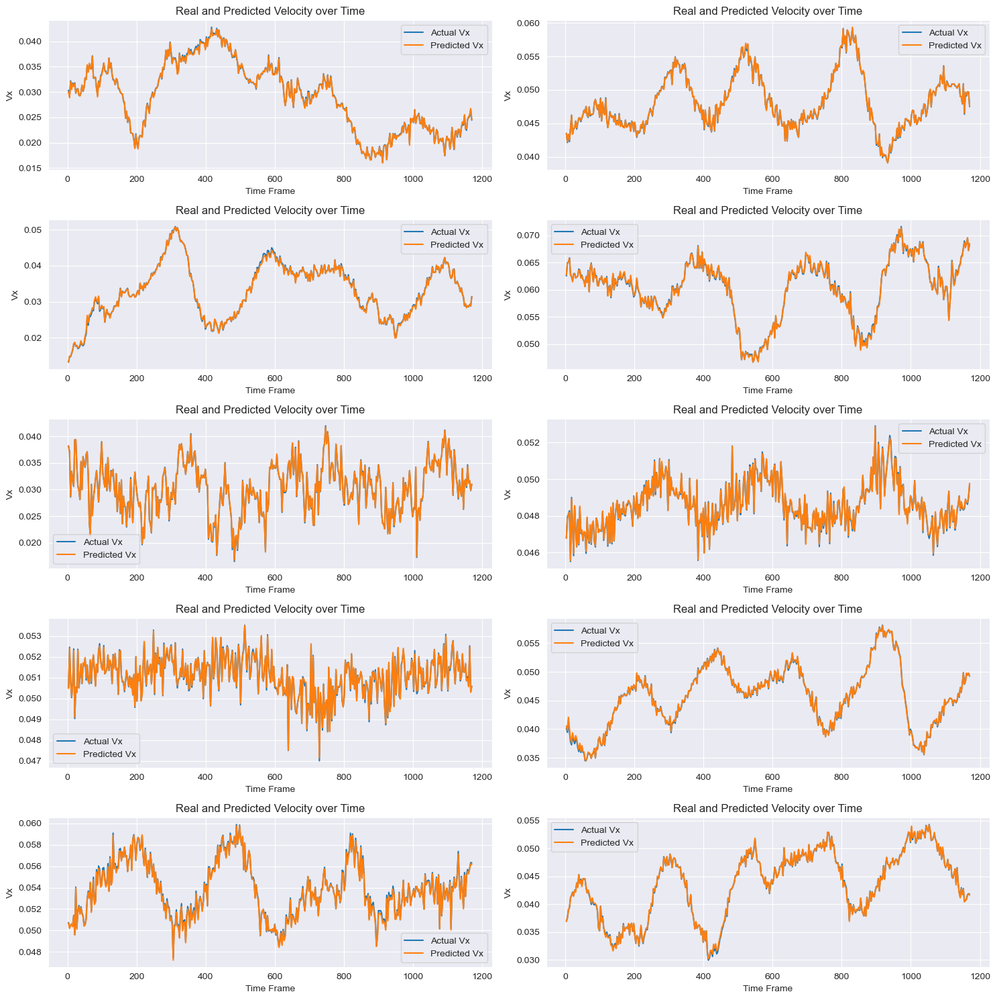

In [5]:
fig, axs = plt.subplots(5, 2, figsize=(15, 15))
axes = axs.flatten() 

for index, (df_index, row) in enumerate(random_df.iterrows()):
    if index > 9:
        break
    ax = axes[index]
    ax.plot(df['time'][(df["x"] == row["x"]) & (df["y"] == row["y"]) & (df["z"] == row["z"])],
            df['vx_x'][(df["x"] == row["x"]) & (df["y"] == row["y"]) & (df["z"] == row["z"])], label='Actual Vx')
    ax.plot(df['time'][(df["x"] == row["x"]) & (df["y"] == row["y"]) & (df["z"] == row["z"])],
            df['vx_y'][(df["x"] == row["x"]) & (df["y"] == row["y"]) & (df["z"] == row["z"])], label='Predicted Vx')
    ax.set_xlabel('Time Frame')
    ax.set_ylabel('Vx')
    ax.set_title('Real and Predicted Velocity over Time')
    ax.legend()

plt.tight_layout()
fig.savefig(f"Real and Predicted Velocity over Time.png", dpi=300)
plt.show()


In [ ]:
for index, row in random_df.iterrows():
    plt.plot(df['time'][(df["x"]==row["x"]) & (df["y"]==row["y"]) & (df["z"]==row["z"])], df['vx_x'][(df["x"]==row["x"]) & (df["y"]==row["y"]) & (df["z"]==row["z"])], label='vx_x')
    plt.plot(df['time'][(df["x"]==row["x"]) & (df["y"]==row["y"]) & (df["z"]==row["z"])], df['vx_y'][(df["x"]==row["x"]) & (df["y"]==row["y"]) & (df["z"]==row["z"])], label='vx_y')
    
    plt.xlabel('Time Frame')
    plt.ylabel('Vx')
    
    plt.title('Real and Predicted Velocity over Time')
    plt.legend()
    plt.show()


In [6]:
def contour_plot(df, time_frame, title,  label):
    fig, axs = plt.subplots(1, 3, figsize=(30, 10), subplot_kw=dict(projection='3d')) 

    # Subplot 1
    ax = axs[0]
    ax.set_facecolor("white")
    ax.set_title('Vx', fontsize=16)
    img = ax.scatter(df[df["time"]==time_frame]['x'], df[df["time"]==time_frame]['y'], df[df["time"]==time_frame]['z'], c=df[df["time"]==time_frame][f"vx_{label}"], cmap=plt.hot())
    fig.colorbar(img, ax=ax)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    
    # Subplot 2
    ax = axs[1]
    ax.set_facecolor("white")
    ax.set_title('Vy', fontsize=16)
    img = ax.scatter(df[df["time"]==time_frame]['x'], df[df["time"]==time_frame]['y'], df[df["time"]==time_frame]['z'], c=df[df["time"]==time_frame][f"vy_{label}"], cmap=plt.hot())
    fig.colorbar(img, ax=ax)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    
    # Subplot 3
    ax = axs[2]
    ax.set_facecolor("white")
    ax.set_title('Vz', fontsize=16)
    img = ax.scatter(df[df["time"]==time_frame]['x'], df[df["time"]==time_frame]['y'], df[df["time"]==time_frame]['z'], c=df[df["time"]==time_frame][f"vz_{label}"], cmap=plt.hot())
    fig.colorbar(img, ax=ax)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    
    fig.savefig(f"{title}_{time_frame}_{label}.png", dpi=300)
    
    plt.show()
    

In [7]:
def contour_2d(df, time_frame, z, title):
    fig, axs = plt.subplots(2, 2, figsize=(16, 12))

    pivot_table1 = df[(df["time"]==time_frame) & (df["z"]==z)].pivot(index='y', columns='x', values='vx_x')
    sns.heatmap(pivot_table1, ax=axs[0, 0])
    axs[0, 0].set_title('Vx')
    
    pivot_table2 = df[(df["time"]==time_frame) & (df["z"]==z)].pivot(index='y', columns='x', values='vy_x')
    sns.heatmap(pivot_table2, ax=axs[0, 1])
    axs[0, 1].set_title('Vy')
    
    pivot_table3 = df[(df["time"]==time_frame) & (df["z"]==z)].pivot(index='y', columns='x', values='vx_y')
    sns.heatmap(pivot_table3, ax=axs[1, 0])
    axs[1, 0].set_title("Vx Predicted")
    
    pivot_table4 = df[(df["time"]==time_frame) & (df["z"]==z)].pivot(index='y', columns='x', values='vy_y')
    sns.heatmap(pivot_table4, ax=axs[1, 1])
    axs[1, 1].set_title("Vy Predicted")
    
    plt.tight_layout()
    
    fig.savefig(f"{title}_{time_frame}_{z}.png", dpi=300)
    plt.show()

In [8]:
def scatter_plot(df, time_frame, title,  label):

    subplot_titles = ('Vx', 'Vy', 'Vz')
    fig = make_subplots(rows=1, cols=3, subplot_titles=subplot_titles, 
                        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}, {'type': 'scatter3d'}]])
    
    trace1 = go.Scatter3d(
        x= df[(df["time"]==time_frame)]['x'],
        y=df[(df["time"]==time_frame)]['y'],
        z=df[(df["time"]==time_frame)]['z'],
        mode='markers',
        marker=dict(
            size=6,
            color=df[(df["time"]==time_frame)][f"vx_{label}"],
            colorscale='blackbody',
            opacity=0.35,
            colorbar=dict(x=0.33)
        )
    )
    
    trace2 = go.Scatter3d(
        x=df[(df["time"]==time_frame)]['x'],
        y=df[(df["time"]==time_frame)]['y'],
        z=df[(df["time"]==time_frame)]['z'],
        mode='markers',
        marker=dict(
            size=6,
            color=df[(df["time"]==time_frame)][f"vy_{label}"],
            colorscale='blackbody',
            opacity=0.35,
            colorbar=dict(x=0.67)
        )
    )
    
    trace3 = go.Scatter3d(
        x=df[(df["time"]==time_frame)]['x'],
        y=df[(df["time"]==time_frame)]['y'],
        z=df[(df["time"]==time_frame)]['z'],
        mode='markers',
        marker=dict(
            size=6,
            color=df[(df["time"]==time_frame)][f"vz_{label}"],  
            colorscale='blackbody',
            opacity=0.35,
            colorbar=dict(x=1)
        )
    )
    
    fig.append_trace(trace1, 1, 1)
    fig.append_trace(trace2, 1, 2)
    fig.append_trace(trace3, 1, 3)
    pio.write_html(fig, f"{title}_{time_frame}_{label}.html")
    fig.update_layout(width=1500)
    fig.show()

In [9]:
fig = px.scatter_3d(df[df["time"] == 5], x='x', y='y', z='z', color='vx_x', opacity=0.35)
fig.show()

In [80]:
fig = px.scatter_3d(df_orig, x='x', y='y', z='z', color='vx', opacity=0.35)
fig.show()

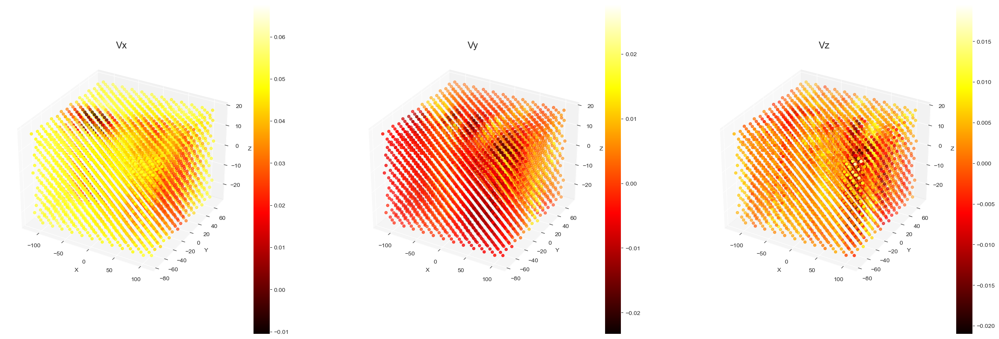

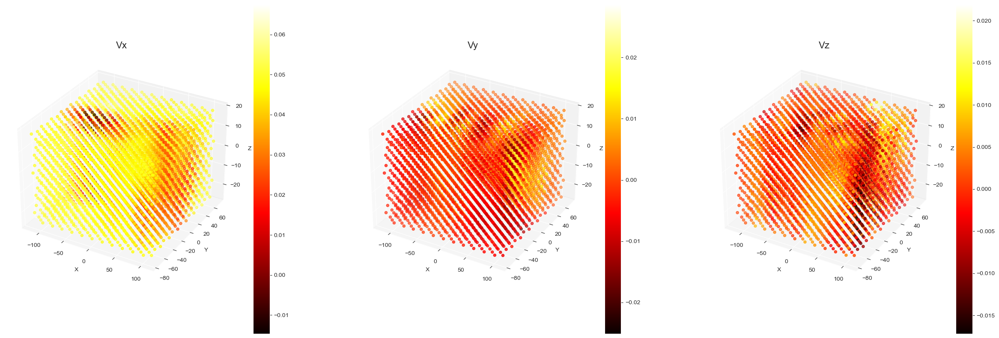

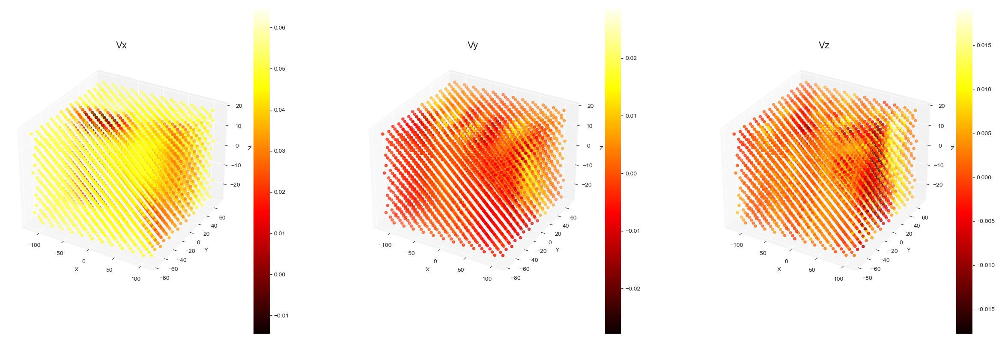

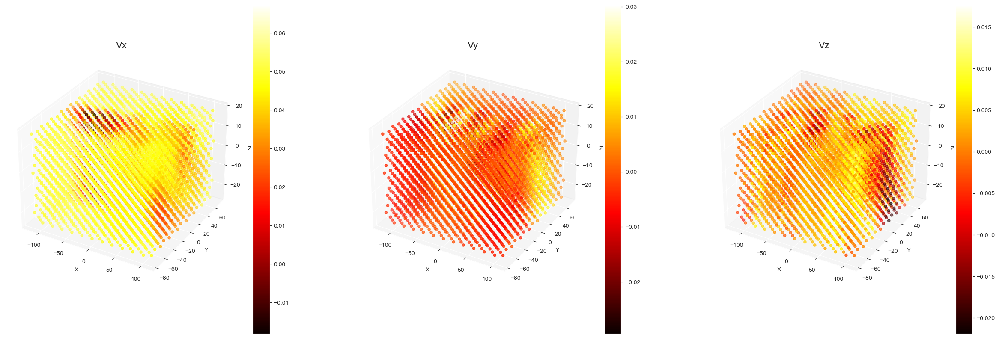

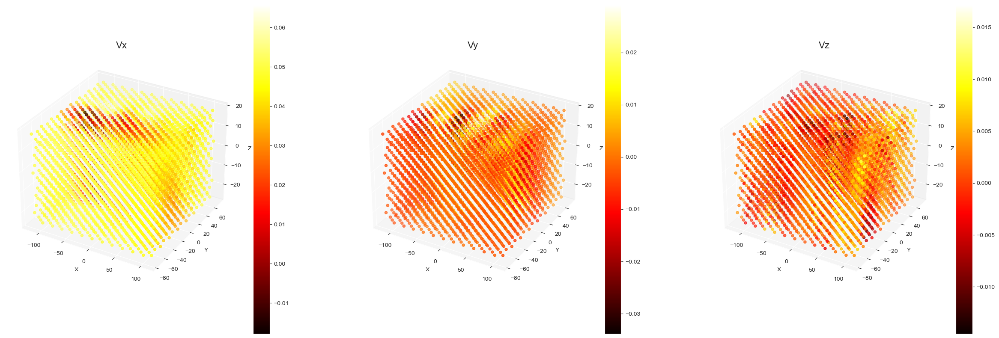

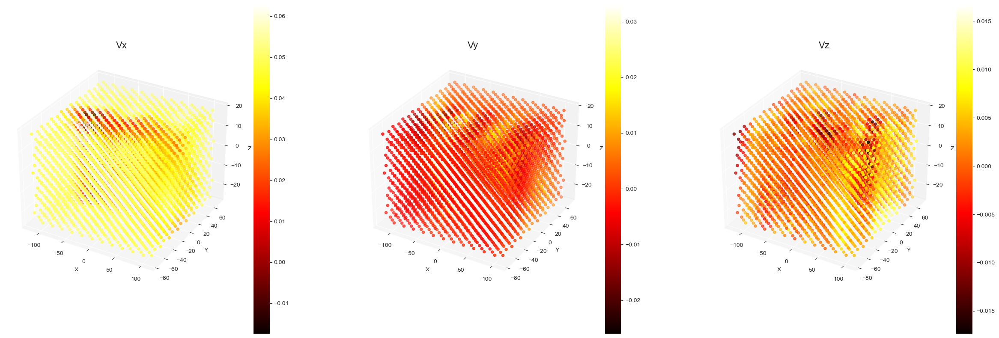

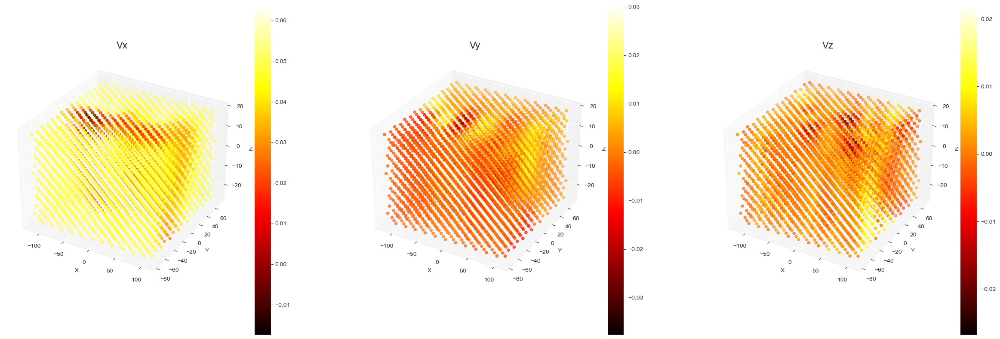

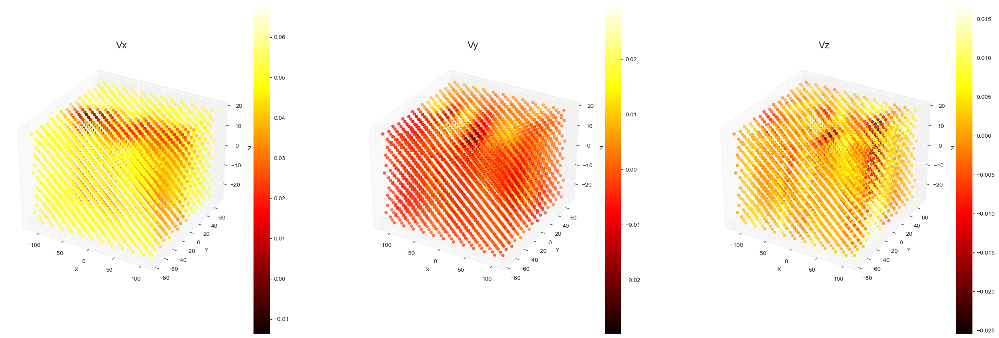

In [11]:
contour_plot(df, 120, "3D_Plot", "x")
contour_plot(df, 180, "3D_Plot", "x")
contour_plot(df, 240, "3D_Plot", "x")
contour_plot(df, 300, "3D_Plot", "x")
contour_plot(df, 450, "3D_Plot", "x")
contour_plot(df, 600, "3D_Plot", "x")
contour_plot(df, 750, "3D_Plot", "x")
contour_plot(df, 900, "3D_Plot", "x")

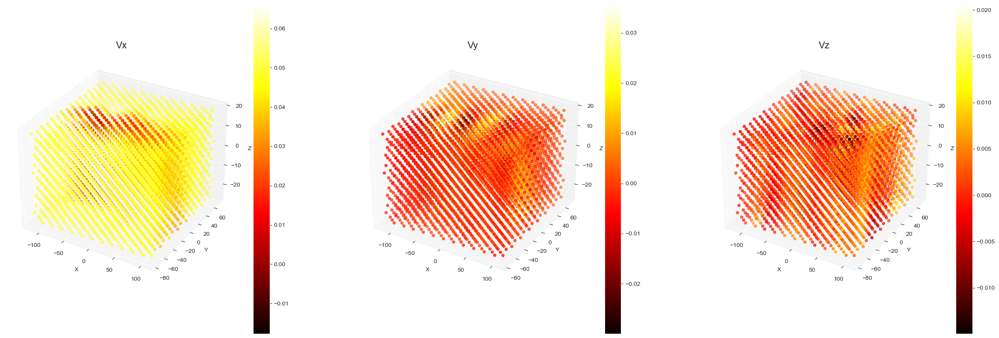

In [48]:
contour_plot(df, 500, "3D_Plot", "y")

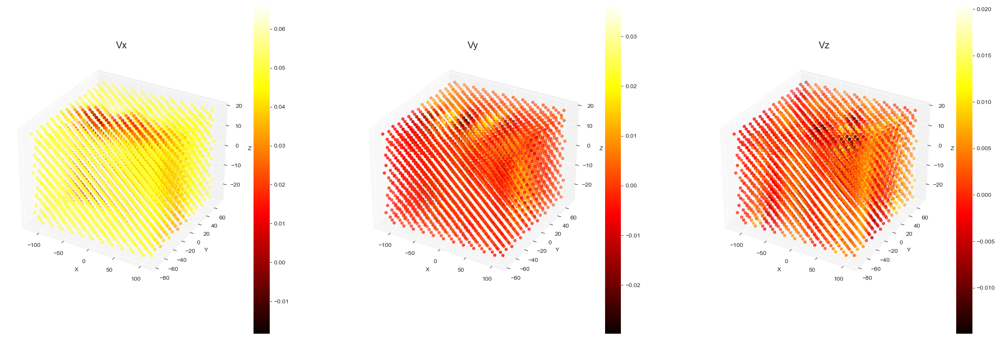

In [67]:
contour_plot(df, 500, "3D_Plot", "x")

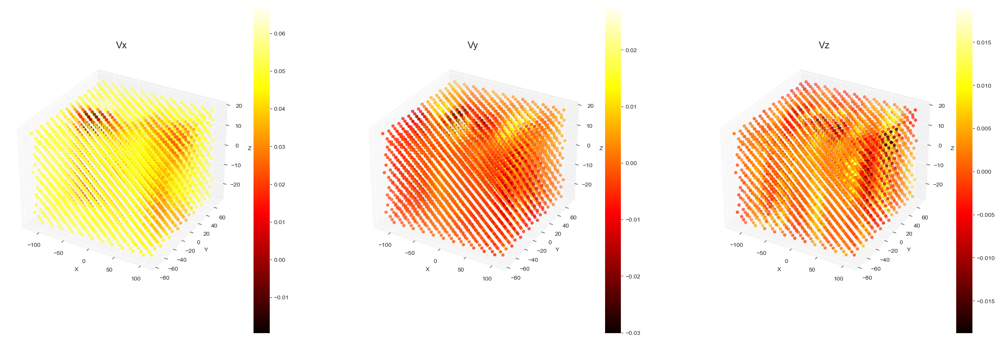

In [62]:
contour_plot(df, 1200, "3D_Plot", "y")

25th Percentile (Q1):  0.038667399197816865
50th Percentile (Q2 or median):  0.04734395563602449
75th Percentile (Q3):  0.04975033414363862


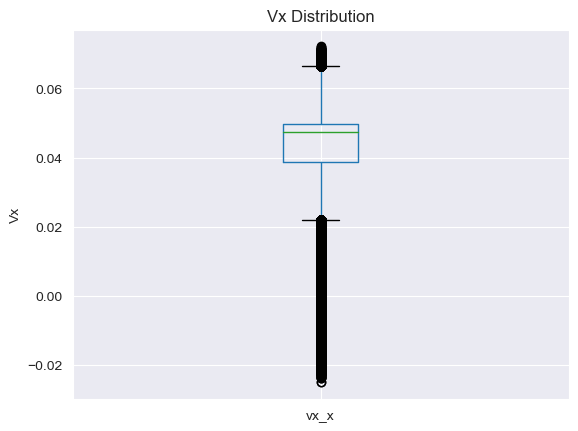

In [12]:
boxplot = df.boxplot(column=['vx_x'])

# displaying the 25th, 50th and 75th percentiles
q1 = df['vx_x'].quantile(0.25)
q2 = df['vx_x'].quantile(0.50)
q3 = df['vx_x'].quantile(0.75)
print("25th Percentile (Q1): ", q1)
print("50th Percentile (Q2 or median): ", q2)
print("75th Percentile (Q3): ", q3)

plt.title('Vx Distribution')
plt.ylabel('Vx')
plt.savefig(f"Vx_dist.png", dpi=300)

plt.show()

In [13]:
errors =[]

In [14]:
errors.append({"population":"Q1", "velocity": "x", "mae":df[df["vx_x"]<=q1]["vx_error"].mean()})
errors.append({"population":"Q2", "velocity": "x",  "mae":df[df["vx_x"]<=q2]["vx_error"].mean()})
errors.append({"population":"Q2", "velocity": "x",  "mae":df[df["vx_x"]<=q3]["vx_error"].mean()})
errors.append({"population":"Total", "velocity": "x",  "mae":df["vx_error"].mean()})
errors.append({"population":"Q1", "velocity": "y", "mae":df[df["vx_x"]<=q1]["vy_error"].mean()})
errors.append({"population":"Q2", "velocity": "y",  "mae":df[df["vx_x"]<=q2]["vy_error"].mean()})
errors.append({"population":"Q2", "velocity": "y",  "mae":df[df["vx_x"]<=q3]["vy_error"].mean()})
errors.append({"population":"Total", "velocity": "y",  "mae":df["vy_error"].mean()})
errors.append({"population":"Q1", "velocity": "z", "mae":df[df["vx_x"]<=q1]["vz_error"].mean()})
errors.append({"population":"Q2", "velocity": "z",  "mae":df[df["vx_x"]<=q2]["vz_error"].mean()})
errors.append({"population":"Q2", "velocity": "z",  "mae":df[df["vx_x"]<=q3]["vz_error"].mean()})
errors.append({"population":"Total", "velocity": "z",  "mae":df["vz_error"].mean()})
df_errors = pd.DataFrame(errors)
df_errors.to_csv("Errors.csv", index=False)
df_errors

,population,velocity,mae
0,Q1,x,0.000151
1,Q2,x,0.000126
2,Q2,x,0.000104
3,Total,x,0.000096
4,Q1,y,0.000180
5,Q2,y,0.000151
6,Q2,y,0.000122
7,Total,y,0.000111
8,Q1,z,0.000153
9,Q2,z,0.000131


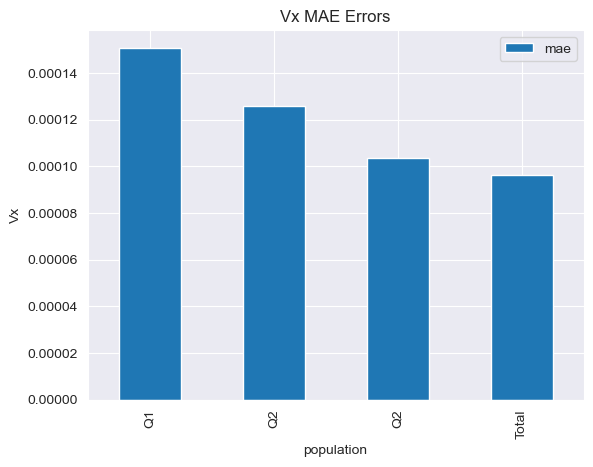

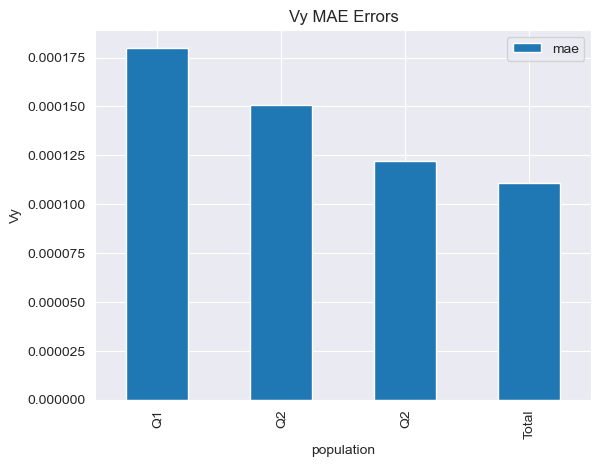

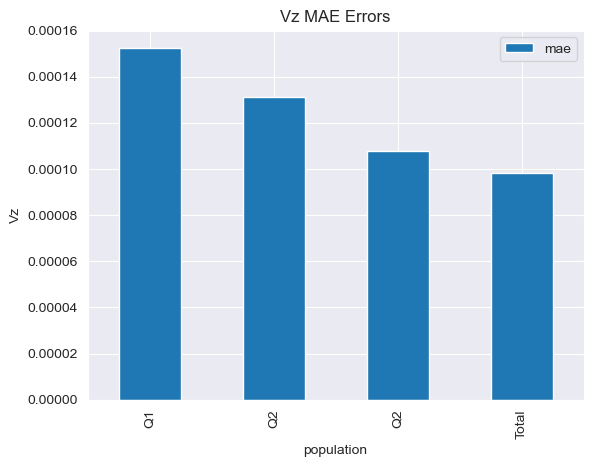

In [15]:
for i in ["x","y","z"]:
    df_errors[df_errors["velocity"]==i].plot(kind="bar", x="population", y="mae")
    plt.title(f"V{i} MAE Errors")
    plt.ylabel(f"V{i}")
    plt.savefig(f"mae_errors_{i}.png", dpi=300)
    plt.show()

In [54]:
df["vx_error"].mean(), df["vy_error"].mean(), df["vz_error"].mean()

(9.614446690675781e-05, 0.00011043694451338628, 9.838232596508725e-05)

In [16]:
df["vx_error"].mean(), df["vy_error"].mean(), df["vz_error"].mean()

(9.614027224577535e-05, 0.00011072144353547487, 9.811795158434425e-05)

In [72]:
q1

0.03870542827248574

In [17]:
print(f"Out of {len(df_orig)} rows")
print(f"Vx: There are {len(df[((df['vx_x'] > 0) & (df['vx_y'] < 0)) | ((df['vx_x'] < 0) & (df['vx_y'] > 0))])} rows where one of vx_x and vx_y is positive and the other is negative.")
print(f"Vy: There are {len(df[((df['vy_x'] > 0) & (df['vy_y'] < 0)) | ((df['vy_x'] < 0) & (df['vy_y'] > 0))])} rows where one of vy_x and vy_y is positive and the other is negative.")
print(f"Vy: There are {len(df[((df['vz_x'] > 0) & (df['vz_y'] < 0)) | ((df['vz_x'] < 0) & (df['vz_y'] > 0))])} rows where one of vz_x and vz_y is positive and the other is negative.")

NameError: name 'df_orig' is not defined

25th Percentile (Q1):  -17.0
50th Percentile (Q2 or median):  -3.0
75th Percentile (Q3):  7.0


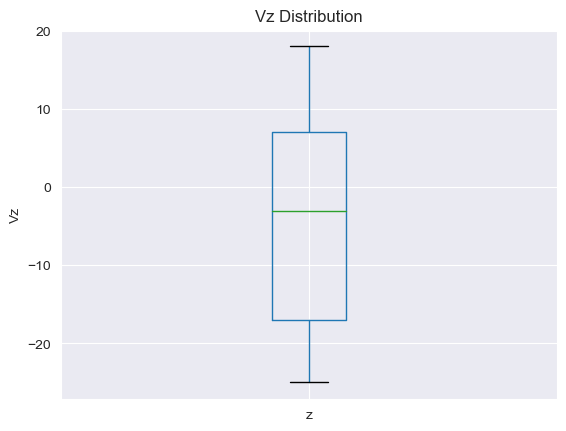

In [90]:
boxplot = df.boxplot(column=['z'])

# displaying the 25th, 50th and 75th percentiles
q1 = df['z'].quantile(0.25)
q2 = df['z'].quantile(0.50)
q3 = df['z'].quantile(0.75)
print("25th Percentile (Q1): ", q1)
print("50th Percentile (Q2 or median): ", q2)
print("75th Percentile (Q3): ", q3)

plt.title('Vz Distribution')
plt.ylabel('Vz')

plt.show()

In [92]:
df.describe()

,x,y,z,vx_x,vy_x,vz_x,vx_y,vy_y,vz_y,vx_error,vy_error,vz_error,time
count,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06,1.269600e+06
mean,-4.215879e+00,-2.330813e+00,-3.168242e+00,4.293326e-02,2.461591e-04,1.466621e-03,4.294852e-02,2.443779e-04,1.482094e-03,9.614447e-05,1.104369e-04,9.838233e-05,6.025000e+02
std,6.631340e+01,4.347760e+01,1.357071e+01,1.165555e-02,7.175725e-03,4.409026e-03,1.164234e-02,7.147467e-03,4.383901e-03,9.765121e-05,1.163551e-04,9.678922e-05,3.464073e+02
min,-1.170000e+02,-7.600000e+01,-2.500000e+01,-2.466801e-02,-3.998411e-02,-3.038831e-02,-2.373938e-02,-4.028057e-02,-3.101437e-02,0.000000e+00,0.000000e+00,0.000000e+00,5.000000e+00
25%,-6.200000e+01,-4.000000e+01,-1.700000e+01,3.870543e-02,-3.666337e-03,-6.299286e-04,3.872822e-02,-3.643994e-03,-5.989525e-04,3.042877e-05,3.175056e-05,3.146142e-05,3.037500e+02
50%,-4.000000e+00,-0.000000e+00,-3.000000e+00,4.734456e-02,4.472635e-04,1.778612e-03,4.736692e-02,4.530739e-04,1.799519e-03,6.738389e-05,7.216161e-05,6.933904e-05,6.025000e+02
75%,5.300000e+01,3.500000e+01,7.000000e+00,4.975138e-02,4.011050e-03,3.980443e-03,4.975802e-02,3.998679e-03,3.990525e-03,1.288197e-04,1.479719e-04,1.321930e-04,9.012500e+02
max,1.090000e+02,7.100000e+01,1.800000e+01,7.242001e-02,3.708423e-02,2.759966e-02,7.213464e-02,3.643644e-02,2.690966e-02,1.942113e-03,2.336379e-03,1.200738e-03,1.200000e+03


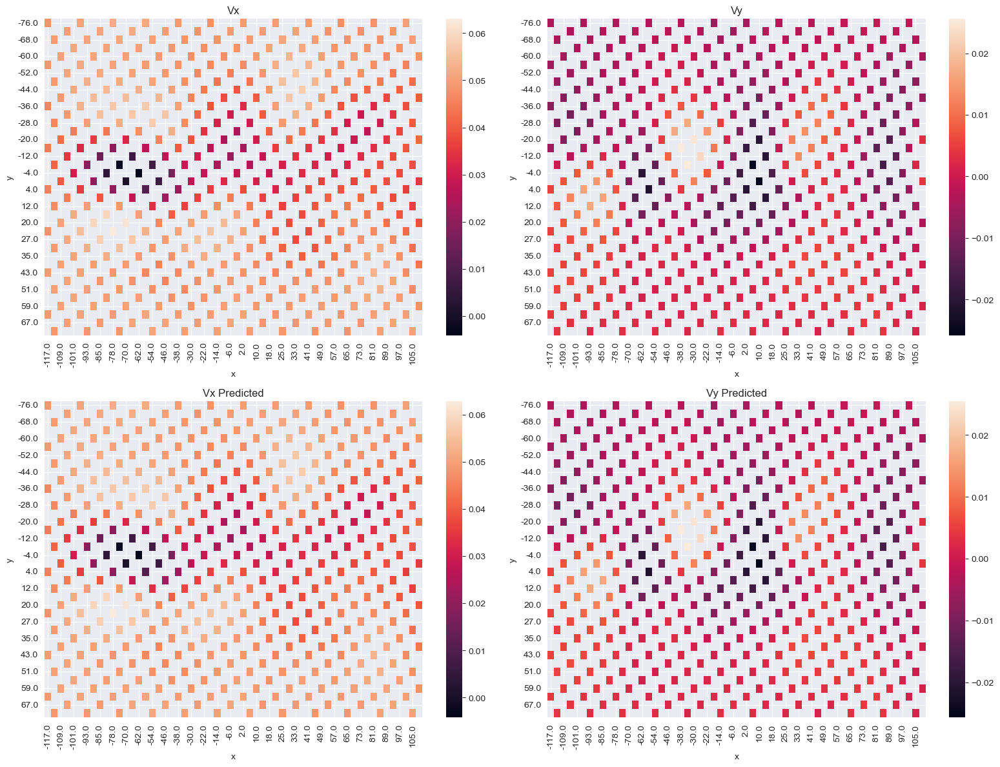

In [18]:
contour_2d(df, 900, -1, "2D-Contour")

In [58]:
scatter_plot(df, 5, "Plotly-3D-Scatter", "x")

In [59]:
scatter_plot(df, 500, "Plotly-3D-Scatter", "x")# Filter dataframe


In [75]:
fig = px.scatter_3d(df[df["time"]==5], x='x', y='y', z='z', color='vx_x', opacity=0.35)
pio.write_html(fig, f"Sampled.html")
fig.show()

In [76]:
fig = px.scatter_3d(df_orig, x='x', y='y', z='z', color='vx', opacity=0.35)
pio.write_html(fig, f"original.html")
fig.show()

In [110]:
filtered_df =df[(df["z"]==-1) & (df["time"]==500)]

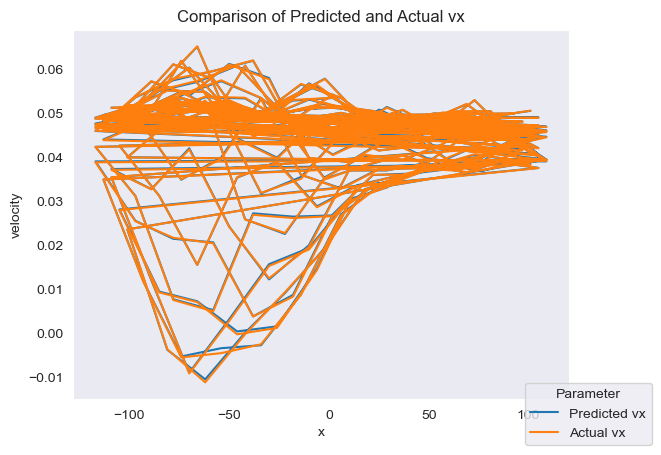

In [109]:
plt.plot(df[(df["z"]==-1) & (df["time"]==500)]['x'], df[(df["z"]==-1) & (df["time"]==500)]['vx_y'], label='Predicted vx')

# plotting actual vx series
plt.plot(df[(df["z"]==-1) & (df["time"]==500)]['x'], df[(df["z"]==-1) & (df["time"]==500)]['vx_x'], label='Actual vx')

# adding legend
plt.legend(title='Parameter', bbox_to_anchor=(1.04, 0), loc="lower right", bbox_transform=plt.gcf().transFigure)

# adding titles and labels
plt.title('Comparison of Predicted and Actual vx')
plt.xlabel('x')
plt.ylabel('velocity')

plt.grid()
plt.show()

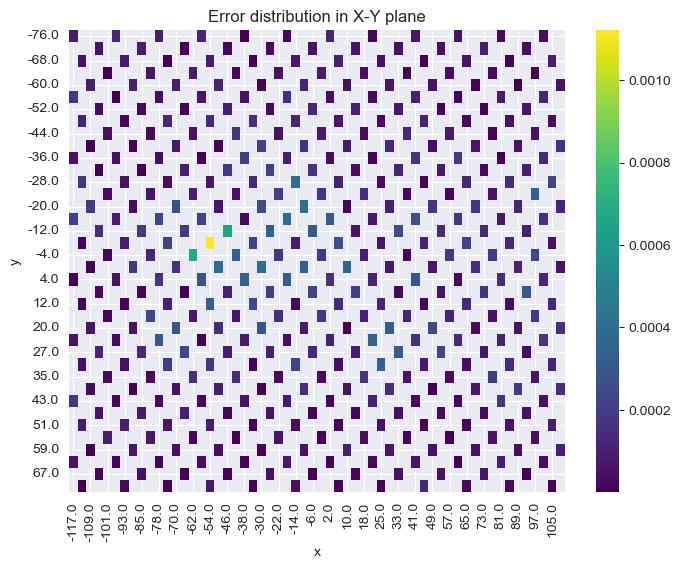

In [121]:
import seaborn as sns

# heatmap_data = filtered_df.pivot('y', 'x', 'vx_error')
heatmap_data = filtered_df.pivot(index="y", columns="x", values="vx_error")

plt.figure(figsize=(8, 6))
sns.heatmap(heatmap_data, cmap='viridis')
plt.title('Error distribution in X-Y plane') 
plt.savefig(f"x_y_Error_dist.png", dpi=300)

plt.show()


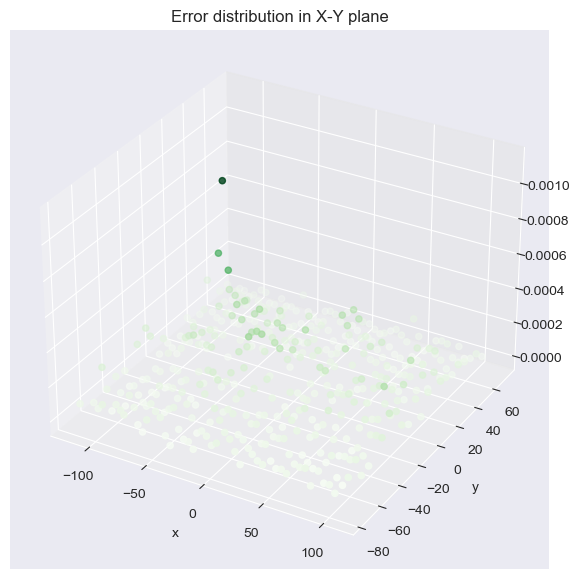

In [124]:
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')

# Data for three-dimensional scattered points
zdata = filtered_df['vx_error']
xdata = filtered_df['x']
ydata = filtered_df['y']
ax.scatter3D(xdata, ydata, zdata, c=zdata, cmap='Greens')
plt.title('Error distribution in X-Y plane') 
plt.xlabel('x')
plt.ylabel('y')
plt.savefig(f"x_y_Error_dist_3d.png", dpi=300)

plt.show()